<a href="https://colab.research.google.com/github/uol-mediaprocessing/group-projects-sudoku-solver/blob/master/main_transformation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Preamble

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
!pip install import_ipynb
import import_ipynb

  Created wheel for import-ipynb: filename=import_ipynb-0.1.3-cp36-none-any.whl size=2975 sha256=4fb6cad07527ca9327843039d6982ba44f6b3f98239ed0f65e1ef78affec9310
  Stored in directory: /root/.cache/pip/wheels/b4/7b/e9/a3a6e496115dffdb4e3085d0ae39ffe8a814eacc44bbf494b5
Successfully built import-ipynb


In [0]:
!wget https://raw.githubusercontent.com/uol-mediaprocessing/group-projects-sudoku-solver/master/defs_common.ipynb -O "defs_common.ipynb"
from defs_common import *

--2020-01-03 11:24:01--  https://raw.githubusercontent.com/uol-mediaprocessing/group-projects-sudoku-solver/master/defs_common.ipynb
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6564 (6.4K) [text/plain]
Saving to: ‘defs_common.ipynb’

defs_common.ipynb   100%[===================>]   6.41K  --.-KB/s    in 0s      

2020-01-03 11:24:01 (89.5 MB/s) - ‘defs_common.ipynb’ saved [6564/6564]

importing Jupyter notebook from defs_common.ipynb


In [0]:
import cv2 as cv
import pandas as pd
import numpy as np
import re

In [0]:
!cp "./drive/My Drive/sudoku_acquisition_output.bz2" "./sudoku_acquisition_output.bz2"
acquisition_output = pd.read_pickle("./sudoku_acquisition_output.bz2")
acquisition_output

,input_image,input_digits,training
input_filename,,,
./v2_train/image1059.jpg,"[[[172, 171, 159], [174, 170, 165], [174, 170,...","[[0, 3, 0, 1, 4, 8, 2, 0, 0], [0, 4, 2, 0, 0, ...",True
./v2_train/image26.jpg,"[[[120, 130, 131], [119, 129, 130], [117, 127,...","[[6, 0, 1, 0, 8, 5, 0, 0, 4], [0, 0, 0, 3, 0, ...",True
./v2_train/image41.jpg,"[[[142, 162, 150], [142, 162, 150], [142, 162,...","[[7, 0, 0, 0, 0, 0, 0, 0, 0], [0, 2, 1, 4, 0, ...",True
./v2_train/image19.jpg,"[[[148, 166, 154], [148, 166, 154], [147, 165,...","[[6, 0, 1, 0, 8, 5, 0, 0, 4], [0, 0, 0, 3, 0, ...",False
./v2_train/image22.jpg,"[[[149, 166, 156], [149, 166, 156], [149, 166,...","[[6, 0, 1, 0, 8, 5, 0, 0, 4], [0, 0, 0, 3, 0, ...",False
...,...,...,...
./dataset/009000800/IMG_8812.JPG,"[[[93, 98, 90], [95, 96, 95], [93, 95, 94], [9...","[[0, 0, 9, 0, 0, 0, 8, 0, 0], [0, 6, 0, 0, 0, ...",True
./dataset/009000800/IMG_8817.JPG,"[[[195, 195, 197], [196, 194, 200], [195, 196,...","[[0, 0, 9, 0, 0, 0, 8, 0, 0], [0, 6, 0, 0, 0, ...",True
./dataset/009000800/IMG_8822.JPG,"[[[15, 15, 14], [15, 15, 17], [14, 14, 16], [1...","[[0, 0, 9, 0, 0, 0, 8, 0, 0], [0, 6, 0, 0, 0, ...",True


In [0]:
!cp "./drive/My Drive/sudoku_detection_output.bz2" "./sudoku_detection_output.bz2"
detection_output = pd.read_pickle("./sudoku_detection_output.bz2")
detection_output

,contour
input_filename,
./v2_train/image1059.jpg,"[[[64, 151]], [[66, 379]], [[444, 378]], [[434..."
./v2_train/image1006.jpg,"[[[57, 64]], [[50, 356]], [[456, 355]], [[445,..."
./v2_train/image1082.jpg,"[[[55, 110]], [[58, 420]], [[463, 413]], [[469..."
./v2_train/image204.jpg,"[[[399, 65]], [[97, 72]], [[95, 474]], [[407, ..."
./v2_train/image201.jpg,"[[[350, 36]], [[448, 42]], [[450, 313]], [[349..."
...,...
./dataset/009000800/IMG_8813.JPG,"[[[379, 131]], [[110, 179]], [[47, 388]], [[38..."
./dataset/009000800/IMG_8819.JPG,"[[[124, 39]], [[116, 381]], [[444, 357]], [[39..."
./dataset/009000800/IMG_8812.JPG,"[[[385, 30]], [[99, 160]], [[51, 421]], [[393,..."


In [0]:
dataset = acquisition_output.join(detection_output, how="inner")
dataset

,input_image,input_digits,training,contour
input_filename,,,,
./v2_train/image1059.jpg,"[[[172, 171, 159], [174, 170, 165], [174, 170,...","[[0, 3, 0, 1, 4, 8, 2, 0, 0], [0, 4, 2, 0, 0, ...",True,"[[[64, 151]], [[66, 379]], [[444, 378]], [[434..."
./v2_train/image1006.jpg,"[[[165, 126, 97], [166, 128, 99], [166, 127, 9...","[[0, 9, 5, 8, 0, 0, 0, 0, 0], [2, 0, 0, 3, 0, ...",True,"[[[57, 64]], [[50, 356]], [[456, 355]], [[445,..."
./v2_train/image1082.jpg,"[[[182, 175, 169], [184, 177, 170], [185, 178,...","[[3, 4, 7, 0, 5, 1, 0, 0, 0], [0, 1, 9, 0, 0, ...",True,"[[[55, 110]], [[58, 420]], [[463, 413]], [[469..."
./v2_train/image204.jpg,"[[[154, 146, 93], [158, 150, 103], [163, 154, ...","[[0, 1, 3, 0, 0, 0, 0, 0, 0], [0, 0, 6, 0, 4, ...",False,"[[[399, 65]], [[97, 72]], [[95, 474]], [[407, ..."
./v2_train/image201.jpg,"[[[98, 109, 105], [96, 107, 103], [97, 108, 10...","[[5, 0, 0, 0, 6, 0, 0, 0, 1], [0, 9, 0, 0, 7, ...",True,"[[[350, 36]], [[448, 42]], [[450, 313]], [[349..."
...,...,...,...,...
./dataset/009000800/IMG_8813.JPG,"[[[92, 94, 88], [94, 94, 90], [93, 94, 89], [9...","[[0, 0, 9, 0, 0, 0, 8, 0, 0], [0, 6, 0, 0, 0, ...",True,"[[[379, 131]], [[110, 179]], [[47, 388]], [[38..."
./dataset/009000800/IMG_8819.JPG,"[[[101, 97, 83], [101, 95, 83], [102, 96, 84],...","[[0, 0, 9, 0, 0, 0, 8, 0, 0], [0, 6, 0, 0, 0, ...",True,"[[[124, 39]], [[116, 381]], [[444, 357]], [[39..."
./dataset/009000800/IMG_8812.JPG,"[[[93, 98, 90], [95, 96, 95], [93, 95, 94], [9...","[[0, 0, 9, 0, 0, 0, 8, 0, 0], [0, 6, 0, 0, 0, ...",True,"[[[385, 30]], [[99, 160]], [[51, 421]], [[393,..."


# Introduction
Because we now know all four corner points of the Sudoku grid, we can apply a transformation to those, removing distortions caused by the camera's perspective.
This transformation is done by first calculating a transformation matrix using OpenCV's `getPerspectiveTransform` and then applying this transformation to our source image using `warpPerspective`.


# Sorting of contour vertices

The method `getPerspectiveTransform` requires us to define a list of source points that are mapped to a list of target points.
For this mapping the order of the points is very important.
If the orders don't match, the resulting image could be rotated by 90°, 180° or 270°.
For this reason, we define a method `sort_corners` that sorts the rectangle's corners in a deterministic way:
- The top-left corner A has the smallest sum of x + y values
- The bottom-left corner B has the largest diff. of y - x values
- The bottom-right corner C has the largest sum of x + y values
- The top-right corner D has the smallest diff. of y - x values

In [0]:
# https://www.pyimagesearch.com/2014/08/25/4-point-opencv-getperspective-transform-example/
def sort_contour(contour):
  corners = np.reshape(contour, (4, 2))
  indices = np.zeros((4,), dtype="int")
  sums = np.sum(corners, axis=1)
  # [0]: top left corner (smallest sum x + y)
  indices[0] = np.argmin(sums)
  # [2]: bottom right corner (largest sum x + y)
  indices[2] = np.argmax(sums)
  diffs = np.diff(corners, axis=1)
  # [1]: bottom left corner (largest diff. y - x)
  indices[1] = np.argmax(diffs)
  # [3]: top right corner (smallest diff. y - x)
  indices[3] = np.argmin(diffs)
  return corners[indices]
  
dataset["sorted"] = [sort_contour(x) for x in dataset["contour"]]

# Defintion of target vertices

For the following transformations we have to define the size of our target square.
This could be done in a static way, e. g. scale every image of a Sudoku grid to a 1024x1024 rectangle, or we choose our target dimensions based on the analyzed image.
We decided to use the detected contours circumfrence as a reference for our square side length, which is calculated by the `get_grid_size` method.  

In [0]:
def get_side_length(contour):
  return int(cv.arcLength(contour, closed = True) / 4)

dataset["side_length"] = [get_side_length(x) for x in dataset["sorted"]]

As we now know the side lengths of our target squares, we can construct the list of target points the source points are mapped to.
These target points correspond to the four corner points of a square, which are constructed by the method `get_target_contour`.

In [0]:
def get_target_contour(side_length):
  a = [0, 0]
  b = [0, side_length]
  c = [side_length, side_length]
  d = [side_length, 0] 
  return np.array([a, b, c, d]) 

dataset["target"] = [get_target_contour(x) for x in dataset["side_length"]] 

# Computation of transformation matrix

From the list of sorted source contours/points and the respective target points we can calculate the necessary linear transformation that warps the source images in the desired way using `get_transformation` which internally invokes OpenCV's `getPerspectiveTransform`. 

In [0]:
def get_transformation(source, destination):
  source = source.astype("float32")
  destination = destination.astype("float32")
  return cv.getPerspectiveTransform(source, destination)

dataset["transform_matrix"] = [get_transformation(x, y) for x, y in zip(dataset["sorted"], dataset["target"])]

# Application of transformation matrix

The resulting transformation matrix can in turn be applied to the source image using `apply_transformation` which invokes OpenCV's `warpPerspective` method.
Our source images now look like they have been shot straight from above.
Depending on how the Sudoku grid was oriented within the source image, the output image may be rotated. 

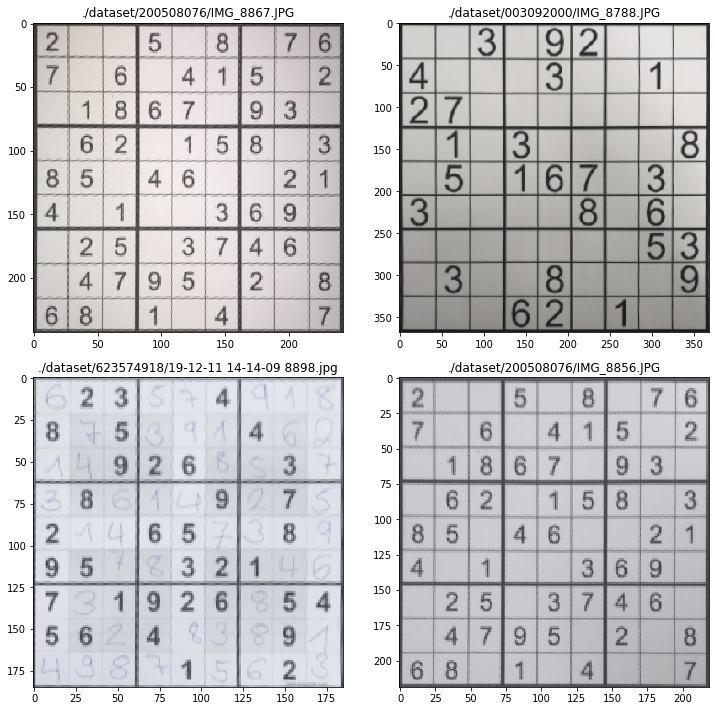

In [0]:
def apply_transformation(image, transformation, side_length):
  return cv.warpPerspective(image, transformation, (side_length, side_length))

dataset["transform_image"] = [apply_transformation(*x) for x in zip(dataset["input_image"], dataset["transform_matrix"], dataset["side_length"])]
show_images(dataset["transform_image"], dataset.index, n_samples=4)

# Filtering of results

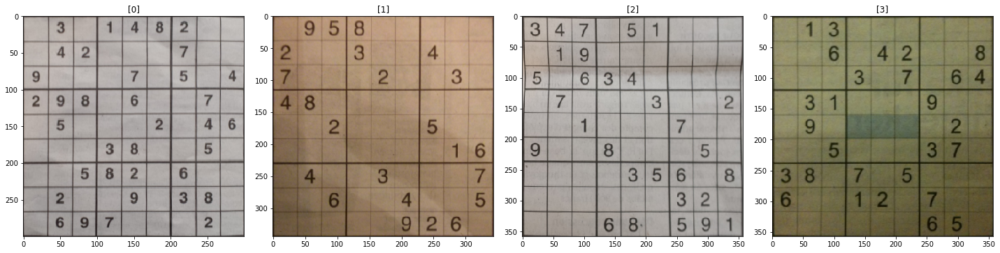

[1/52] Which of these images are valid?0123
[1/52] You have selected indices [0, 1, 2, 3] which are mapped to [0, 1, 2, 3]!


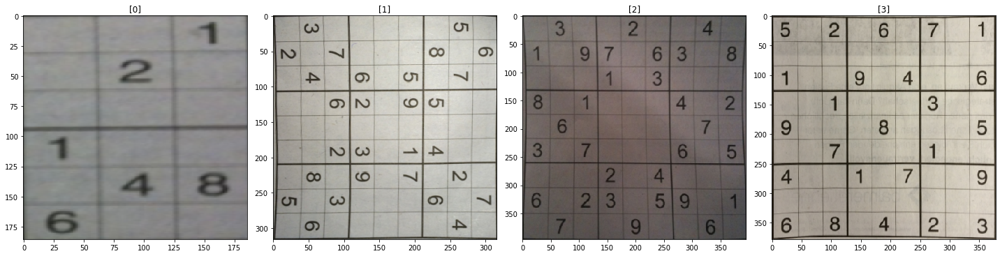

[2/52] Which of these images are valid?23
[2/52] You have selected indices [2, 3] which are mapped to [6, 7]!


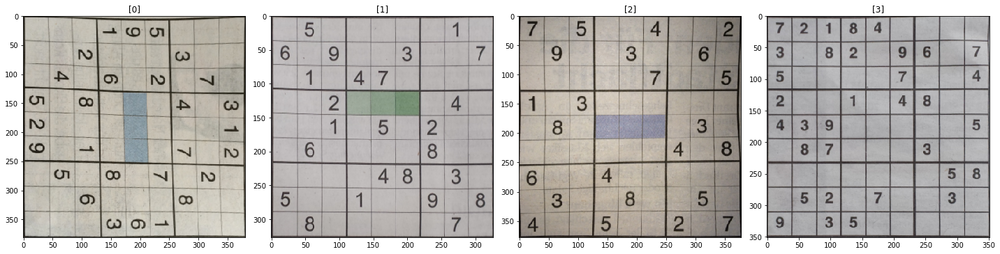

[3/52] Which of these images are valid?123
[3/52] You have selected indices [1, 2, 3] which are mapped to [9, 10, 11]!


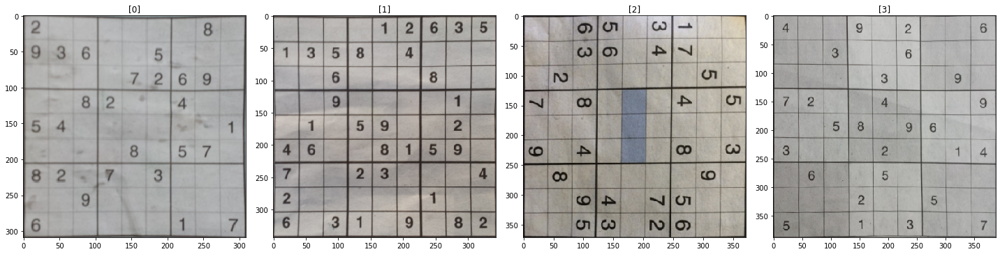

[4/52] Which of these images are valid?013
[4/52] You have selected indices [0, 1, 3] which are mapped to [12, 13, 15]!


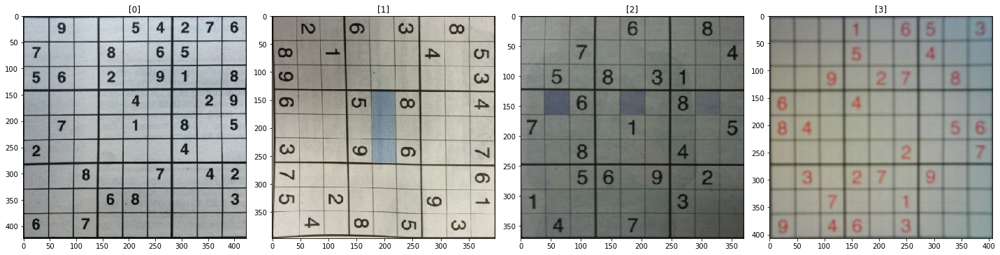

[5/52] Which of these images are valid?023
[5/52] You have selected indices [0, 2, 3] which are mapped to [16, 18, 19]!


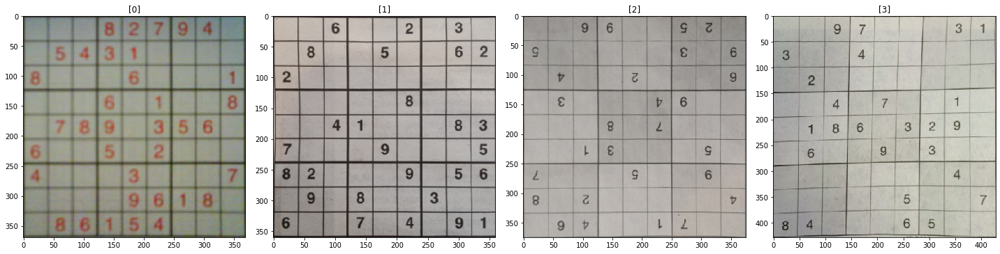

[6/52] Which of these images are valid?0123
[6/52] You have selected indices [0, 1, 2, 3] which are mapped to [20, 21, 22, 23]!


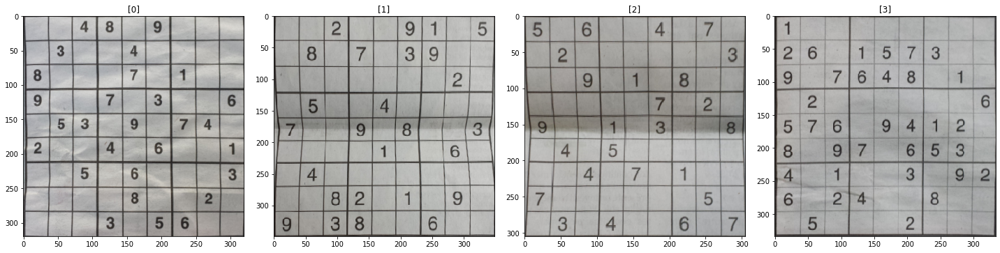

[7/52] Which of these images are valid?0123
[7/52] You have selected indices [0, 1, 2, 3] which are mapped to [24, 25, 26, 27]!


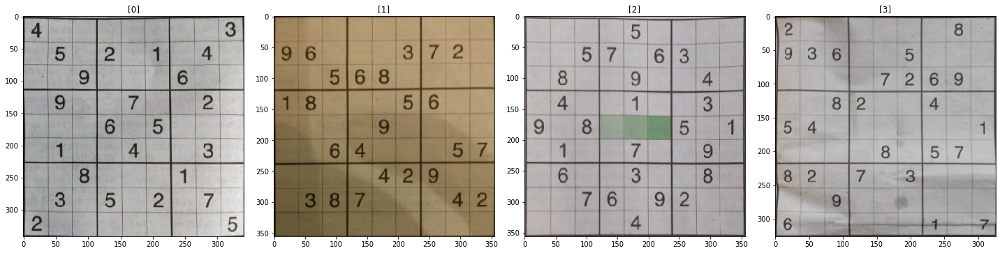

[8/52] Which of these images are valid?0123
[8/52] You have selected indices [0, 1, 2, 3] which are mapped to [28, 29, 30, 31]!


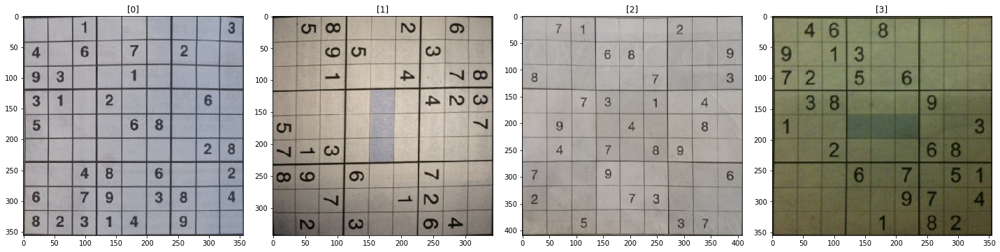

[9/52] Which of these images are valid?023
[9/52] You have selected indices [0, 2, 3] which are mapped to [32, 34, 35]!


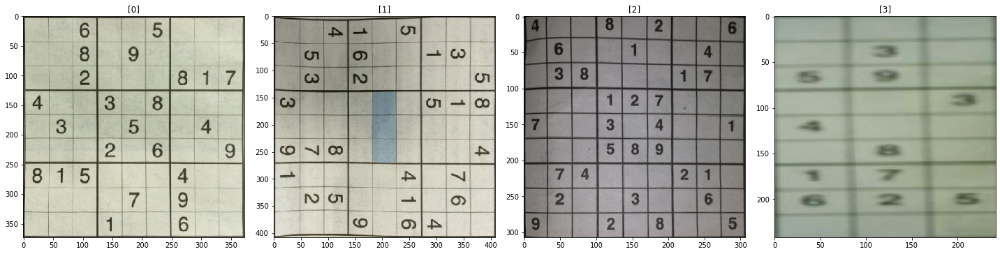

[10/52] Which of these images are valid?02
[10/52] You have selected indices [0, 2] which are mapped to [36, 38]!


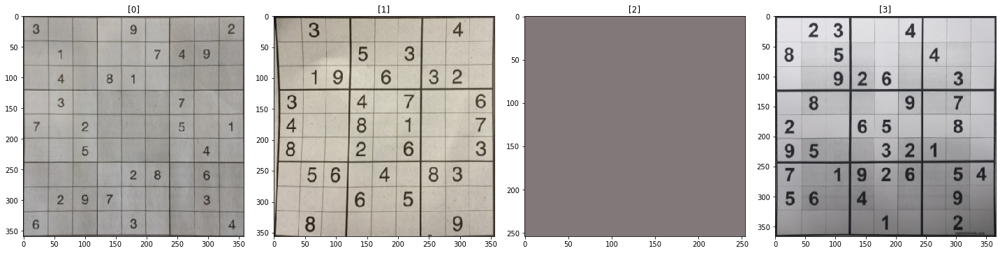

[11/52] Which of these images are valid?013
[11/52] You have selected indices [0, 1, 3] which are mapped to [40, 41, 43]!


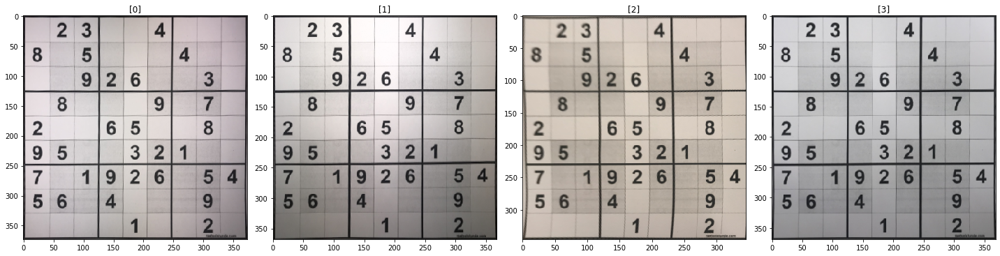

[12/52] Which of these images are valid?0123
[12/52] You have selected indices [0, 1, 2, 3] which are mapped to [44, 45, 46, 47]!


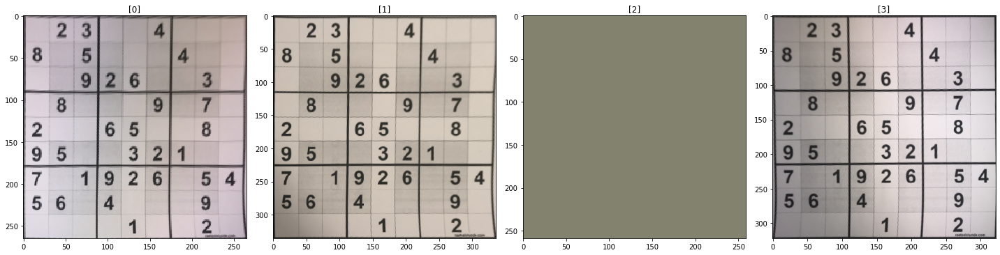

[13/52] Which of these images are valid?013
[13/52] You have selected indices [0, 1, 3] which are mapped to [48, 49, 51]!


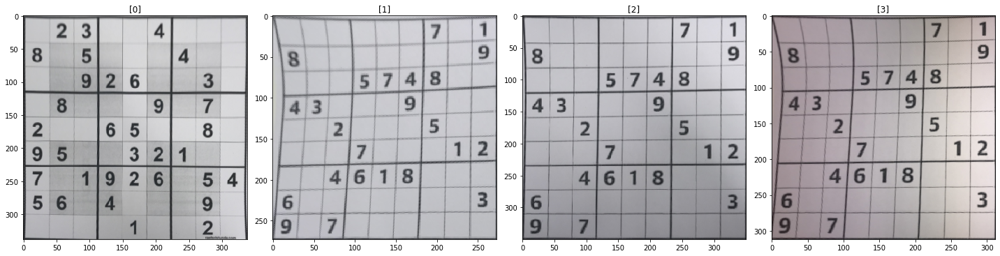

[14/52] Which of these images are valid?02
[14/52] You have selected indices [0, 2] which are mapped to [52, 54]!


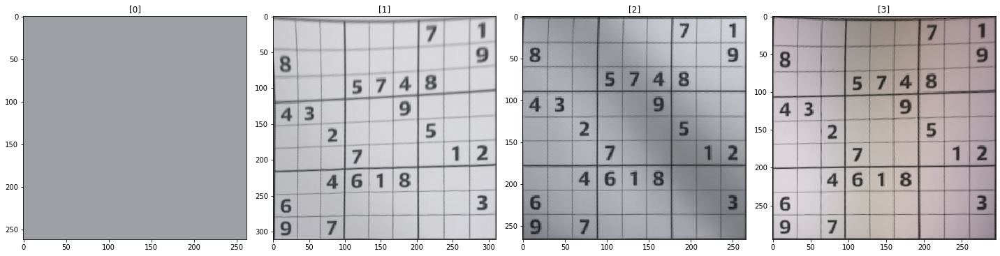

[15/52] Which of these images are valid?123
[15/52] You have selected indices [1, 2, 3] which are mapped to [57, 58, 59]!


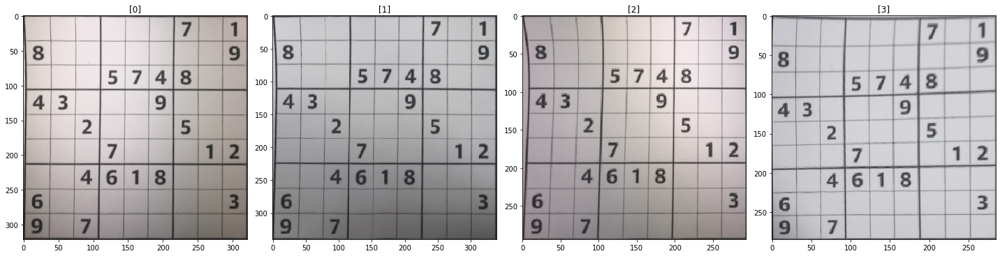

[16/52] Which of these images are valid?0123
[16/52] You have selected indices [0, 1, 2, 3] which are mapped to [60, 61, 62, 63]!


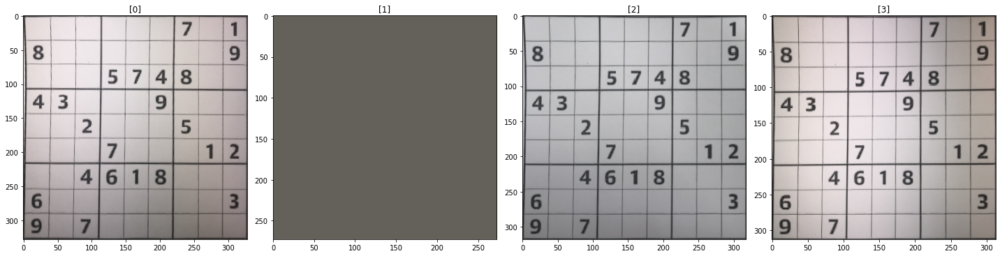

[17/52] Which of these images are valid?023
[17/52] You have selected indices [0, 2, 3] which are mapped to [64, 66, 67]!


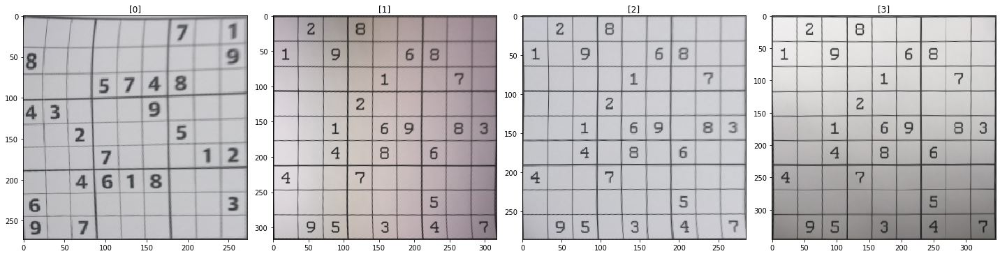

[18/52] Which of these images are valid?0123
[18/52] You have selected indices [0, 1, 2, 3] which are mapped to [68, 69, 70, 71]!


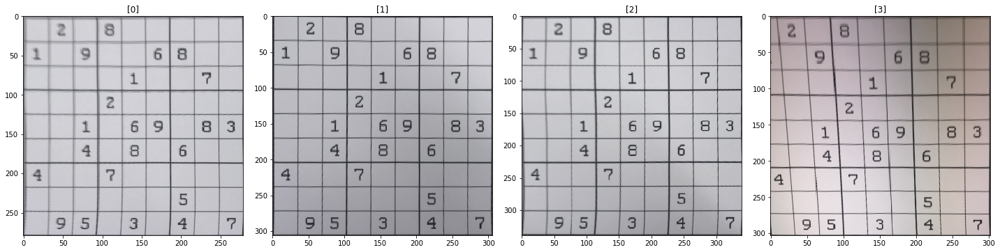

[19/52] Which of these images are valid?012
[19/52] You have selected indices [0, 1, 2] which are mapped to [72, 73, 74]!


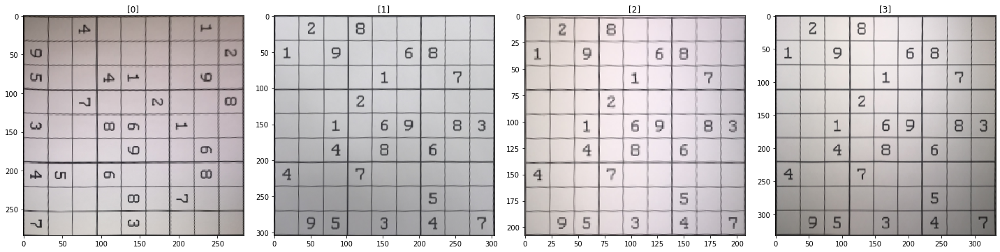

[20/52] Which of these images are valid?123
[20/52] You have selected indices [1, 2, 3] which are mapped to [77, 78, 79]!


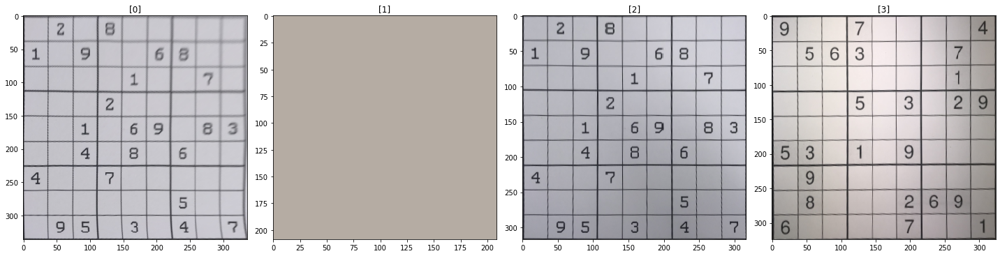

[21/52] Which of these images are valid?023
[21/52] You have selected indices [0, 2, 3] which are mapped to [80, 82, 83]!


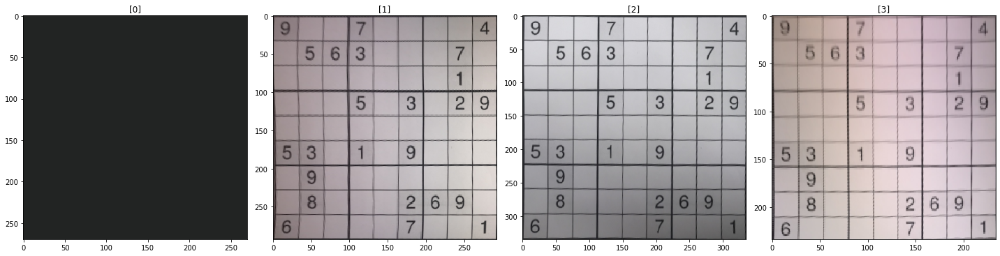

[22/52] Which of these images are valid?123
[22/52] You have selected indices [1, 2, 3] which are mapped to [85, 86, 87]!


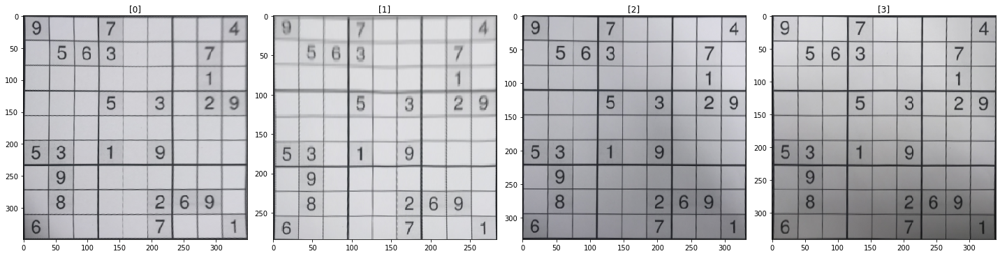

[23/52] Which of these images are valid?0123
[23/52] You have selected indices [0, 1, 2, 3] which are mapped to [88, 89, 90, 91]!


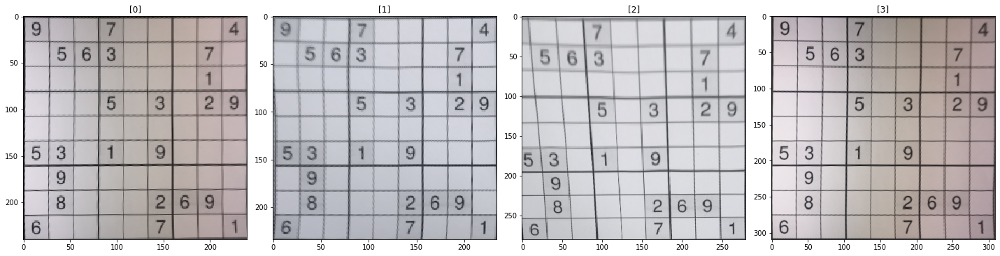

[24/52] Which of these images are valid?013
[24/52] You have selected indices [0, 1, 3] which are mapped to [92, 93, 95]!


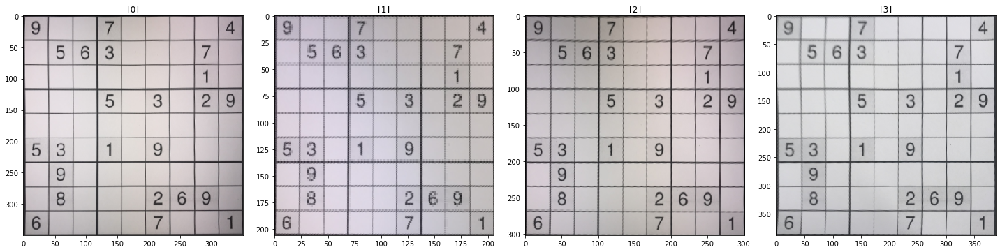

[25/52] Which of these images are valid?0123
[25/52] You have selected indices [0, 1, 2, 3] which are mapped to [96, 97, 98, 99]!


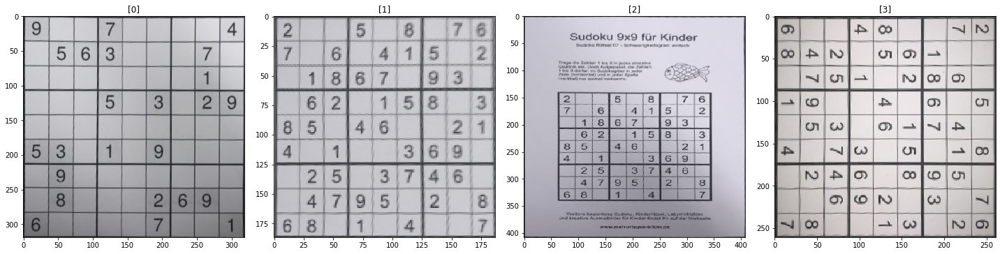

[26/52] Which of these images are valid?01
[26/52] You have selected indices [0, 1] which are mapped to [100, 101]!


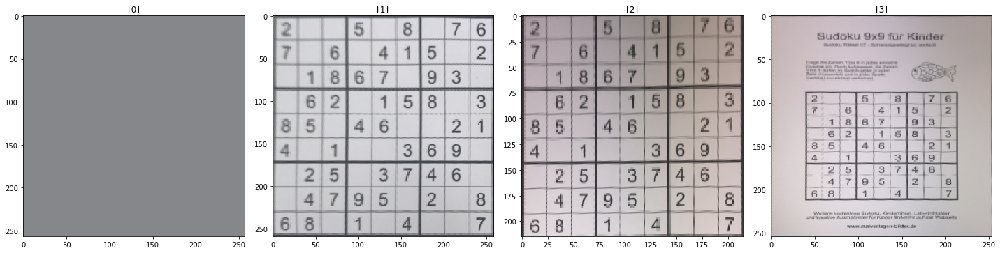

[27/52] Which of these images are valid?12
[27/52] You have selected indices [1, 2] which are mapped to [105, 106]!


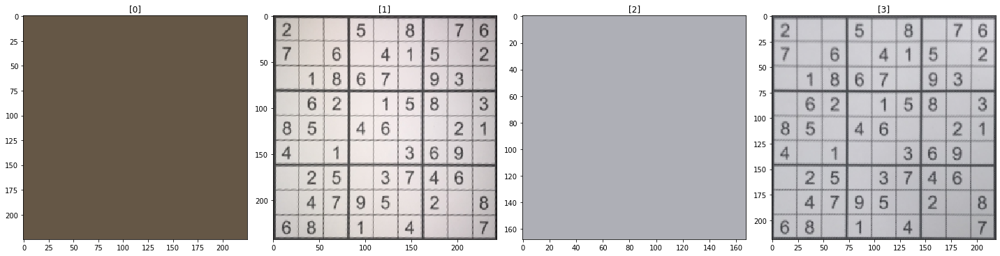

[28/52] Which of these images are valid?13
[28/52] You have selected indices [1, 3] which are mapped to [109, 111]!


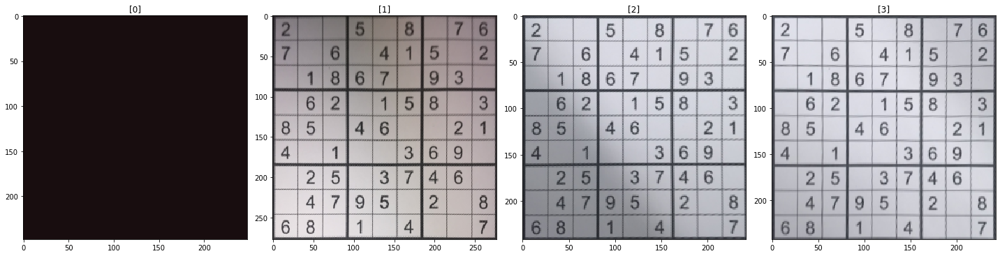

[29/52] Which of these images are valid?123
[29/52] You have selected indices [1, 2, 3] which are mapped to [113, 114, 115]!


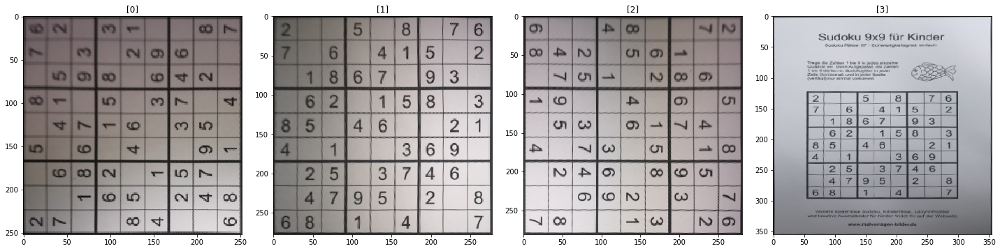

[30/52] Which of these images are valid?1
[30/52] You have selected indices [1] which are mapped to [117]!


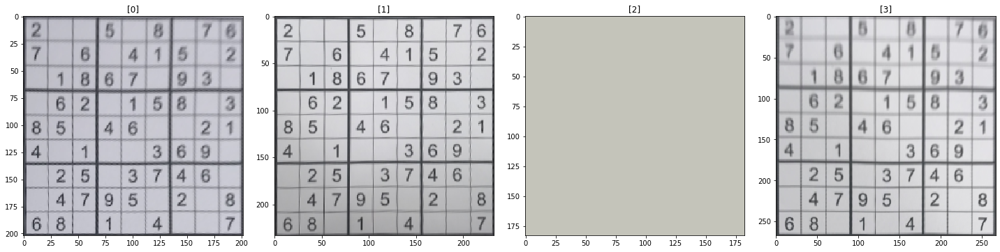

[31/52] Which of these images are valid?013
[31/52] You have selected indices [0, 1, 3] which are mapped to [120, 121, 123]!


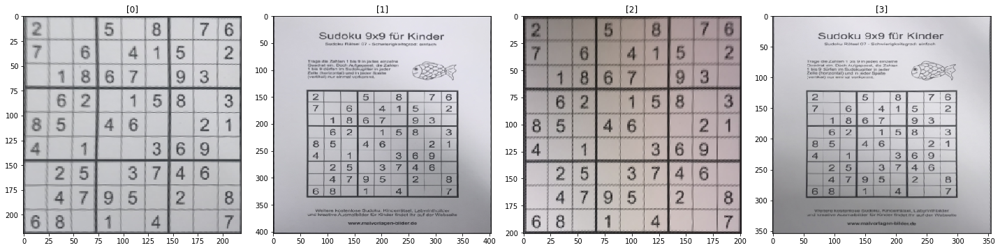

[32/52] Which of these images are valid?02
[32/52] You have selected indices [0, 2] which are mapped to [124, 126]!


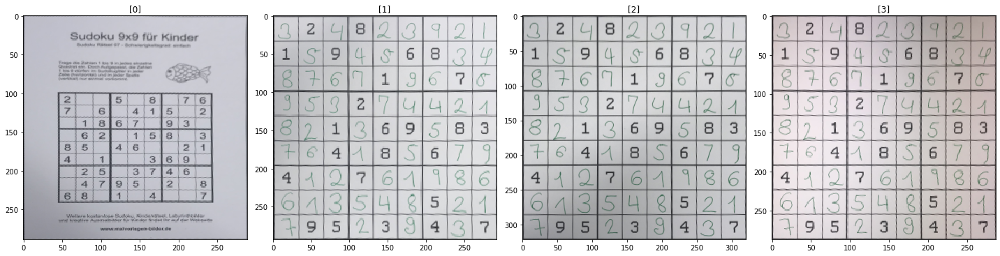

[33/52] Which of these images are valid?123
[33/52] You have selected indices [1, 2, 3] which are mapped to [129, 130, 131]!


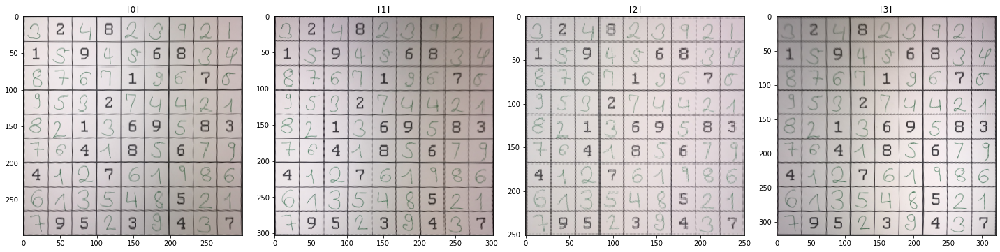

[34/52] Which of these images are valid?0123
[34/52] You have selected indices [0, 1, 2, 3] which are mapped to [132, 133, 134, 135]!


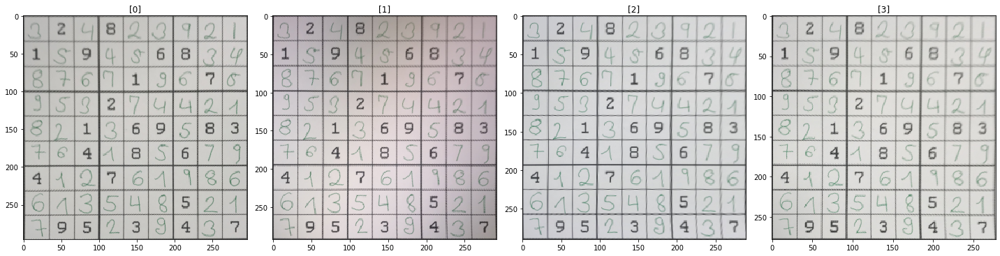

[35/52] Which of these images are valid?0123
[35/52] You have selected indices [0, 1, 2, 3] which are mapped to [136, 137, 138, 139]!


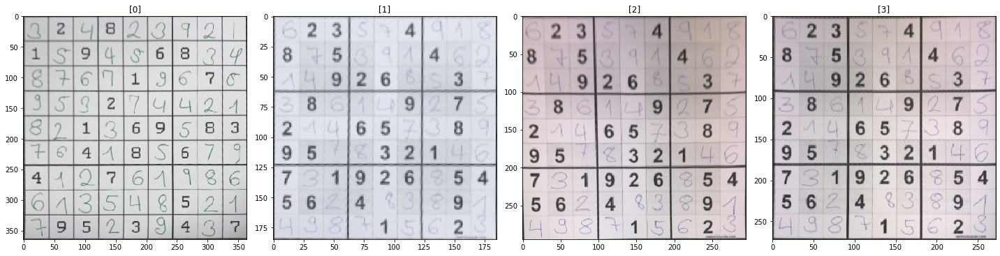

[36/52] Which of these images are valid?0123
[36/52] You have selected indices [0, 1, 2, 3] which are mapped to [140, 141, 142, 143]!


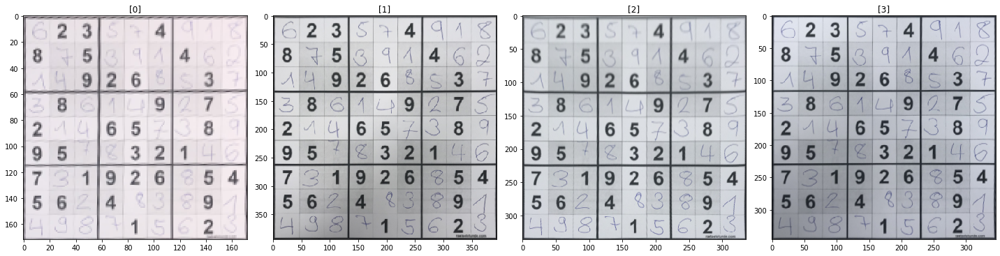

[37/52] Which of these images are valid?0123
[37/52] You have selected indices [0, 1, 2, 3] which are mapped to [144, 145, 146, 147]!


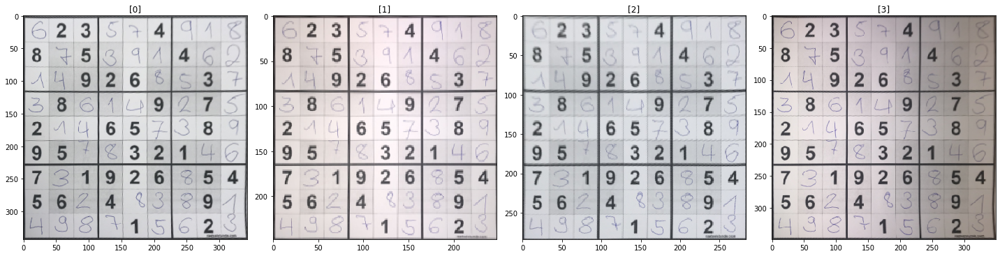

[38/52] Which of these images are valid?0123
[38/52] You have selected indices [0, 1, 2, 3] which are mapped to [148, 149, 150, 151]!


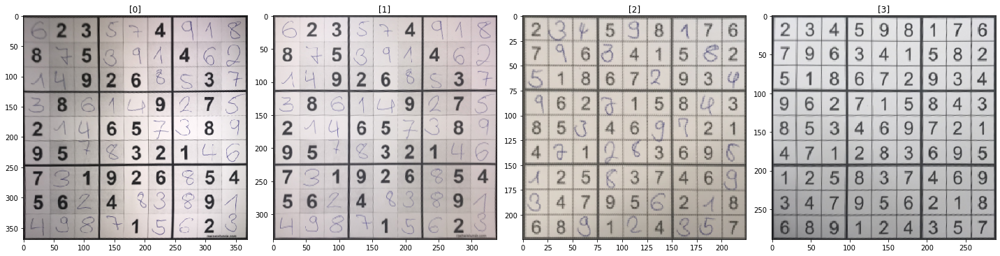

[39/52] Which of these images are valid?0123
[39/52] You have selected indices [0, 1, 2, 3] which are mapped to [152, 153, 154, 155]!


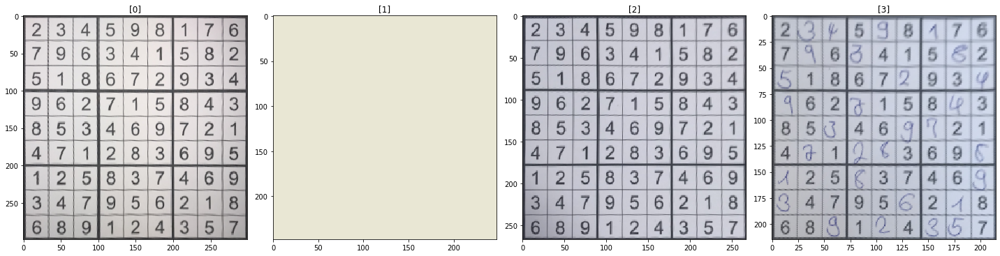

[40/52] Which of these images are valid?023
[40/52] You have selected indices [0, 2, 3] which are mapped to [156, 158, 159]!


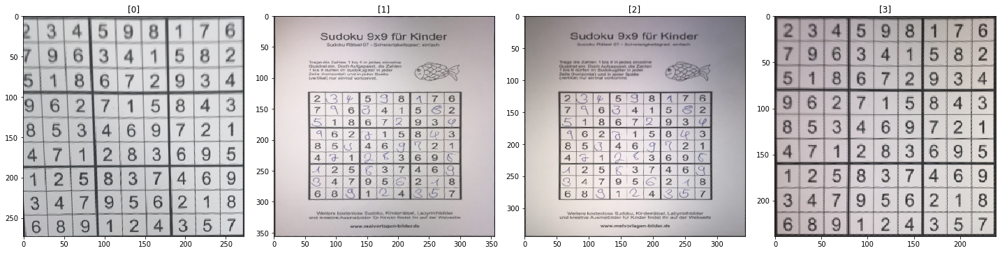

[41/52] Which of these images are valid?3
[41/52] You have selected indices [3] which are mapped to [163]!


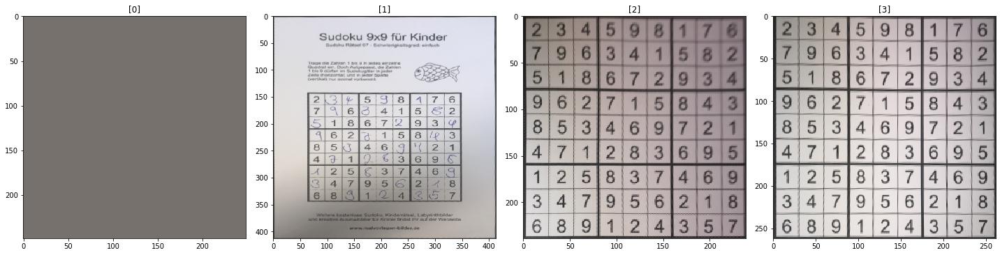

[42/52] Which of these images are valid?23
[42/52] You have selected indices [2, 3] which are mapped to [166, 167]!


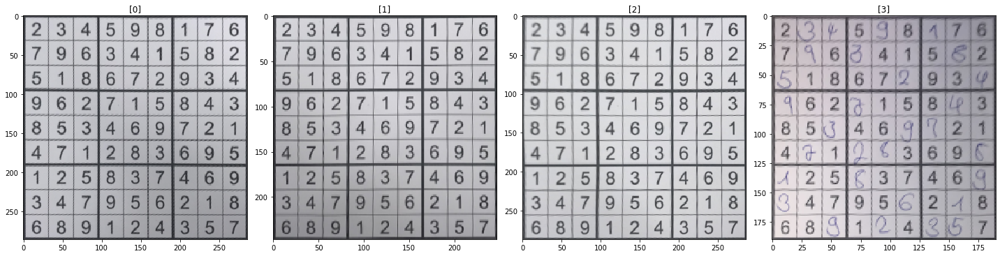

[43/52] Which of these images are valid?0123
[43/52] You have selected indices [0, 1, 2, 3] which are mapped to [168, 169, 170, 171]!


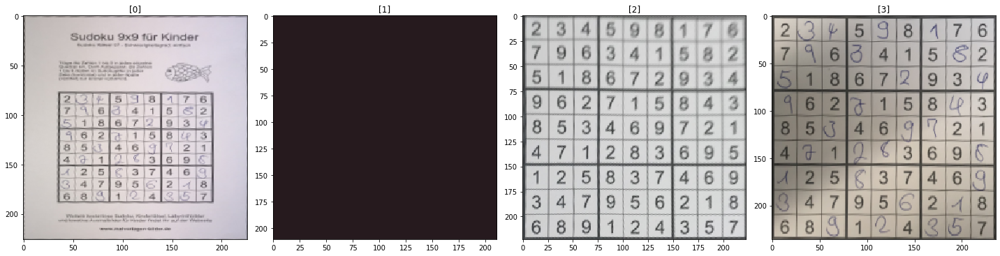

[44/52] Which of these images are valid?23
[44/52] You have selected indices [2, 3] which are mapped to [174, 175]!


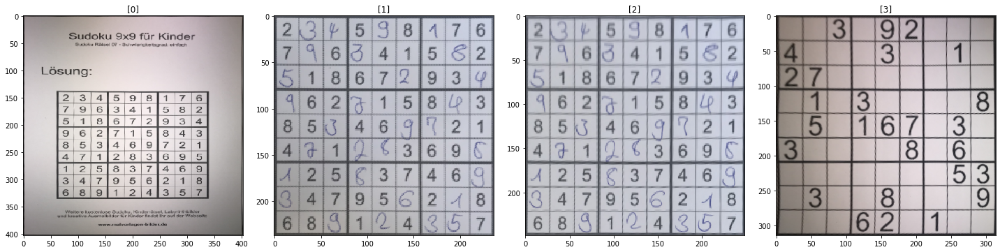

[45/52] Which of these images are valid?123
[45/52] You have selected indices [1, 2, 3] which are mapped to [177, 178, 179]!


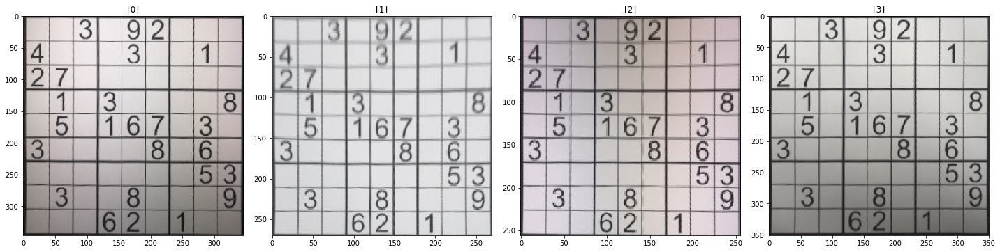

[46/52] Which of these images are valid?0123
[46/52] You have selected indices [0, 1, 2, 3] which are mapped to [180, 181, 182, 183]!


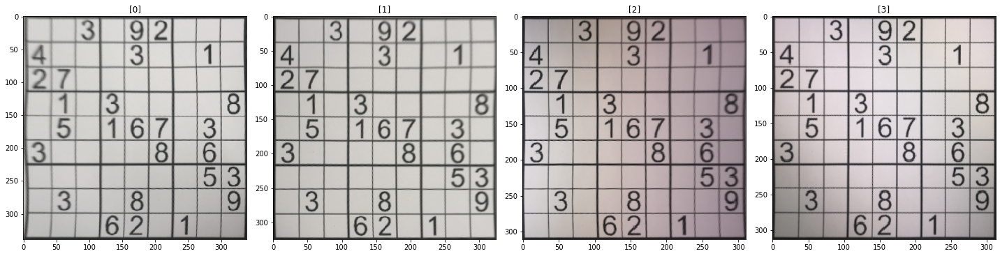

[47/52] Which of these images are valid?0123
[47/52] You have selected indices [0, 1, 2, 3] which are mapped to [184, 185, 186, 187]!


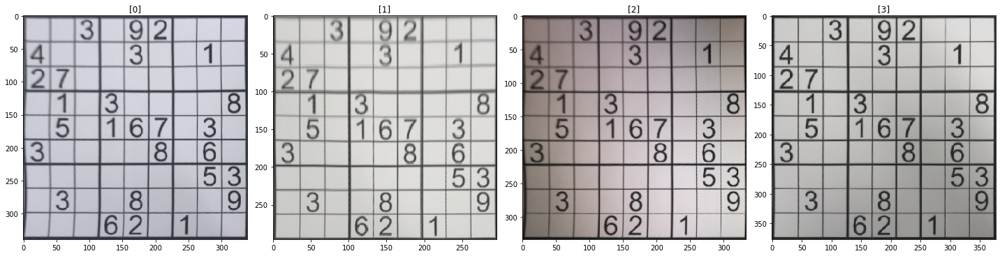

[48/52] Which of these images are valid?0123
[48/52] You have selected indices [0, 1, 2, 3] which are mapped to [188, 189, 190, 191]!


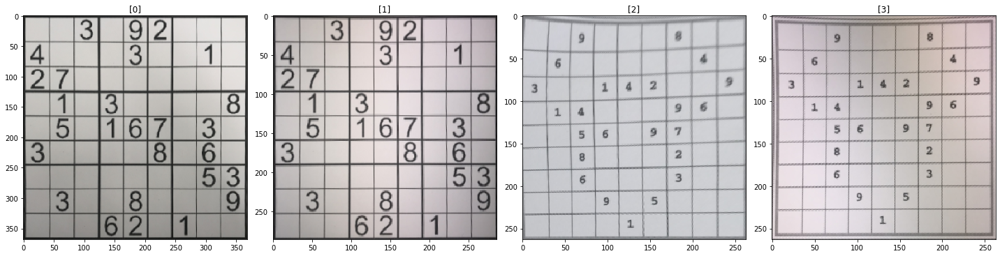

[49/52] Which of these images are valid?0123
[49/52] You have selected indices [0, 1, 2, 3] which are mapped to [192, 193, 194, 195]!


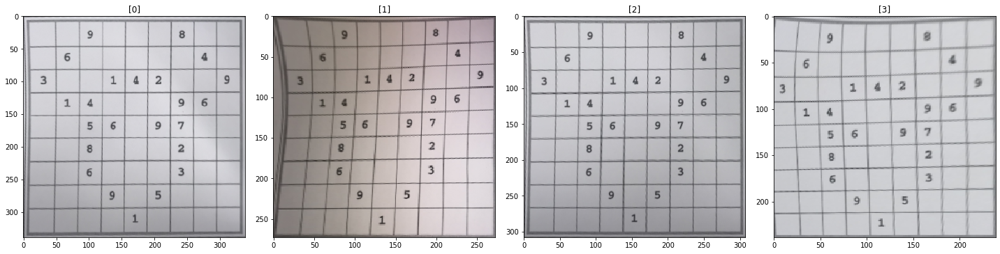

[50/52] Which of these images are valid?023
[50/52] You have selected indices [0, 2, 3] which are mapped to [196, 198, 199]!


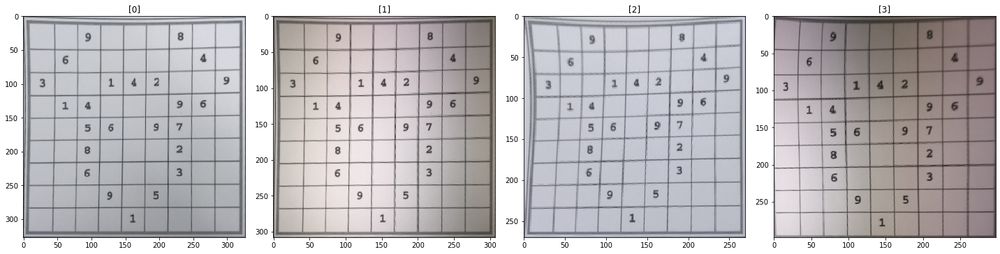

[51/52] Which of these images are valid?0123
[51/52] You have selected indices [0, 1, 2, 3] which are mapped to [200, 201, 202, 203]!


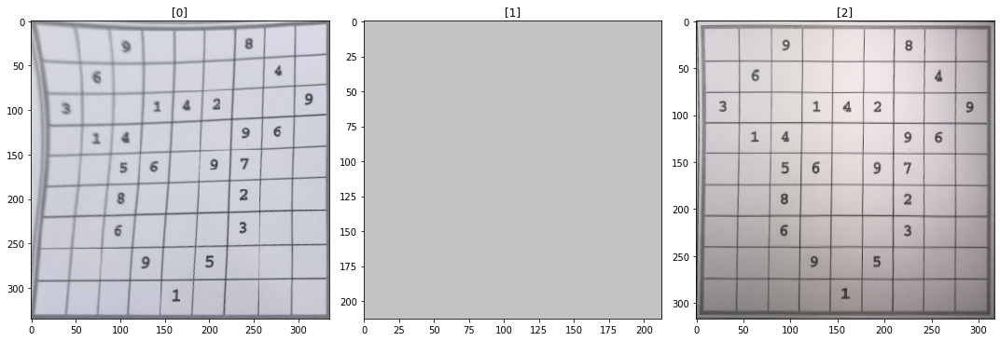

[52/52] Which of these images are valid?2
[52/52] You have selected indices [2] which are mapped to [206]!


In [0]:
indices = np.arange(len(dataset))
n_shown = 4  # number of images to show at once
n_iterations = math.ceil(len(indices) / n_shown)  # number of required iterations
selected_indices = []  # indices that are valid and will be used for further analysis
for i in range(n_iterations):
  subset = indices[i*n_shown:(i+1)*n_shown]  # indices that will be shown in the current iteration
  show_images(dataset["transform_image"][subset], rows=1)
  valid = input("[%d/%d] Which of these images are valid?" % (i + 1, n_iterations))
  valid = re.findall("\d", valid)
  valid = [int(i) for i in valid]
  mapped_valid = [subset[i] for i in valid]  # map local indices (e. g. 0..4) to global indices (e. g. n..n+4)
  print("[%d/%d] You have selected indices %s which are mapped to %s!" % (i + 1, n_iterations, valid, mapped_valid))
  selected_indices.extend(mapped_valid)

In [0]:
dataset_good = dataset.iloc[selected_indices]
print("%d images were selected!" % len(dataset_good))

162 images were selected!


# Export

In [0]:
df = pd.DataFrame({
    "input_filename": dataset_good.index,
    "transform_contour_source": dataset_good["sorted"],
    "transform_contour_target": dataset_good["target"],
    "transform_matrix": dataset_good["transform_matrix"],
    "transform_image": dataset_good["transform_image"]
}).set_index("input_filename")

In [0]:
df

,transform_contour_source,transform_contour_target,transform_matrix,transform_image
input_filename,,,,
./v2_train/image1059.jpg,"[[64, 151], [66, 379], [444, 378], [434, 152]]","[[0, 0], [0, 300], [300, 300], [300, 0]]","[[0.8143743213316917, -0.0071436343976464525, ...","[[[89, 78, 76], [71, 59, 58], [68, 55, 55], [6..."
./v2_train/image1006.jpg,"[[57, 64], [50, 356], [456, 355], [445, 64]]","[[0, 0], [0, 344], [344, 344], [344, 0]]","[[0.8923479678634845, 0.02139190333919314, -52...","[[[105, 69, 40], [85, 51, 24], [91, 58, 34], [..."
./v2_train/image1082.jpg,"[[55, 110], [58, 420], [463, 413], [469, 110]]","[[0, 0], [0, 358], [358, 358], [358, 0]]","[[0.8357188190752205, -0.008087601474921486, -...","[[[100, 91, 80], [68, 59, 51], [67, 60, 53], [..."
./v2_train/image204.jpg,"[[97, 72], [95, 474], [407, 477], [399, 65]]","[[0, 0], [0, 357], [357, 357], [357, 0]]","[[1.228503379336248, 0.006111957111125652, -11...","[[[85, 79, 47], [70, 64, 35], [66, 60, 34], [6..."
./v2_train/image206.jpg,"[[100, 51], [97, 491], [452, 485], [453, 49]]","[[0, 0], [0, 396], [396, 396], [396, 0]]","[[1.1096323446731675, 0.007565675077317018, -1...","[[[57, 57, 51], [54, 54, 48], [55, 54, 50], [5..."
...,...,...,...,...
./dataset/009000800/IMG_8806.JPG,"[[57, 102], [38, 385], [435, 383], [413, 110]]","[[0, 0], [0, 327], [327, 327], [327, 0]]","[[0.9180969420022276, 0.06163901730757003, -58...","[[[104, 103, 109], [78, 79, 84], [89, 90, 95],..."
./dataset/009000800/IMG_8818.JPG,"[[98, 115], [102, 379], [473, 367], [435, 108]]","[[0, 0], [0, 308], [308, 308], [308, 0]]","[[0.9389672429718011, -0.014226776408663582, -...","[[[109, 104, 100], [91, 85, 80], [92, 86, 81],..."
./dataset/009000800/IMG_8813.JPG,"[[110, 179], [47, 388], [385, 382], [379, 131]]","[[0, 0], [0, 270], [270, 270], [270, 0]]","[[2.0894117842015993, 0.6298226909315822, -342...","[[[140, 140, 148], [131, 133, 141], [136, 139,..."


In [0]:
df.to_pickle("./sudoku_transformation_output.bz2")

In [0]:
!cp "./sudoku_transformation_output.bz2" "./drive/My Drive/sudoku_transformation_output.bz2"